In [63]:
# Standard Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Scikit-Learn Preprocessing & Feature Selection
from sklearn.preprocessing import OrdinalEncoder, StandardScaler
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_selection import SelectKBest, f_classif

# Scikit-Learn Model Selection & Evaluation
from sklearn.model_selection import train_test_split, GridSearchCV, learning_curve, cross_val_predict, KFold
from sklearn.metrics import (
    accuracy_score, confusion_matrix, classification_report, 
    precision_recall_curve, roc_auc_score, precision_score, 
    recall_score, f1_score, make_scorer
)

# Machine Learning Models
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, 
    AdaBoostClassifier, ExtraTreesClassifier
)
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# Save/Load Models
import joblib

# Additional Utilities
from sklearn import preprocessing


In [64]:
# Reading File
df = pd.read_csv('D:/next gen thesis/Test interface part/dataset/Train_data_Dataset.csv', encoding='latin')

In [65]:
df.head(5)

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_label
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,25,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal
1,0,udp,other,SF,146,0,0,0,0,0,...,1,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal
2,0,tcp,private,S0,0,0,0,0,0,0,...,26,0.10,0.05,0.00,0.00,1.00,1.00,0.00,0.00,anomaly
3,0,tcp,http,SF,232,8153,0,0,0,0,...,255,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal
4,0,tcp,http,SF,199,420,0,0,0,0,...,255,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal


In [66]:
df.tail()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_label
25187,0,tcp,exec,RSTO,0,0,0,0,0,0,...,7,0.03,0.06,0.00,0.00,0.0,0.0,1.0,1.0,anomaly
25188,0,tcp,ftp_data,SF,334,0,0,0,0,0,...,39,1.00,0.00,1.00,0.18,0.0,0.0,0.0,0.0,anomaly
25189,0,tcp,private,REJ,0,0,0,0,0,0,...,13,0.05,0.07,0.00,0.00,0.0,0.0,1.0,1.0,anomaly
25190,0,tcp,nnsp,S0,0,0,0,0,0,0,...,20,0.08,0.06,0.00,0.00,1.0,1.0,0.0,0.0,anomaly
25191,0,tcp,finger,S0,0,0,0,0,0,0,...,49,0.19,0.03,0.01,0.00,1.0,1.0,0.0,0.0,anomaly


In [67]:
#display info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   duration                     25192 non-null  int64  
 1   protocol_type                25192 non-null  object 
 2   service                      25192 non-null  object 
 3   flag                         25192 non-null  object 
 4   src_bytes                    25192 non-null  int64  
 5   dst_bytes                    25192 non-null  int64  
 6   land                         25192 non-null  int64  
 7   wrong_fragment               25192 non-null  int64  
 8   urgent                       25192 non-null  int64  
 9   hot                          25192 non-null  int64  
 10  num_failed_logins            25192 non-null  int64  
 11  logged_in                    25192 non-null  int64  
 12  num_compromised              25192 non-null  int64  
 13  root_shell      

In [68]:
df.describe().style.background_gradient(cmap='Blues').set_properties(**{'font-family':'Segoe UI'})

,duration,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,num_outbound_cmds,is_host_login,is_guest_login,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate
count,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000,25192.000000
mean,305.054104,24330.628215,3491.847174,0.000079,0.023738,0.000040,0.198039,0.001191,0.394768,0.227850,0.001548,0.001350,0.249841,0.014727,0.000357,0.004327,0.000000,0.000000,0.009130,84.591180,27.698754,0.286338,0.283762,0.118630,0.120260,0.660559,0.062363,0.095931,182.532074,115.063036,0.519791,0.082539,0.147453,0.031844,0.285800,0.279846,0.117800,0.118769
std,2686.555640,2410805.402028,88830.718330,0.008910,0.260221,0.006300,2.154202,0.045418,0.488811,10.417352,0.039316,0.048785,11.500842,0.529602,0.018898,0.098524,0.000000,0.000000,0.095115,114.673451,72.468242,0.447312,0.447599,0.318745,0.322335,0.439637,0.178550,0.256583,98.993895,110.646850,0.448944,0.187191,0.308367,0.110575,0.445316,0.446075,0.305869,0.317333
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.090000,0.000000,0.000000,84.000000,10.000000,0.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,44.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,8.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,255.000000,61.000000,0.510000,0.030000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,279.000000,530.250000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,144.000000,18.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.060000,0.000000,255.000000,255.000000,1.000000,0.070000,0.060000,0.020000,1.000000,1.000000,0.000000,0.000000
max,42862.000000,381709090.000000,5151385.000000,1.000000,3.000000,1.000000,77.000000,4.000000,1.000000,884.000000,1.000000,2.000000,975.000000,40.000000,1.000000,8.000000,0.000000,0.000000,1.000000,511.000000,511.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,255.000000,255.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [69]:
# Data preprocessing

In [70]:
df['attack_label'].value_counts()

attack_label
normal     13449
anomaly    11743
Name: count, dtype: int64

In [71]:
#Number of sentences
label = list(set(df["attack_label"].values))
print("Class:", label)
label_n = len(label)
print("Number of Labels: ", label_n)

Class: ['anomaly', 'normal']
Number of Labels:  2


In [72]:
#checking missing values
df.isnull().sum()

duration                       0
protocol_type                  0
service                        0
flag                           0
src_bytes                      0
dst_bytes                      0
land                           0
wrong_fragment                 0
urgent                         0
hot                            0
num_failed_logins              0
logged_in                      0
num_compromised                0
root_shell                     0
su_attempted                   0
num_root                       0
num_file_creations             0
num_shells                     0
num_access_files               0
num_outbound_cmds              0
is_host_login                  0
is_guest_login                 0
count                          0
srv_count                      0
serror_rate                    0
srv_serror_rate                0
rerror_rate                    0
srv_rerror_rate                0
same_srv_rate                  0
diff_srv_rate                  0
srv_diff_h

In [73]:
#number of normal and intrusion
x,y= df['attack_label'].value_counts()
print("Normal:",x)
print("anomaly:",y)

Normal: 13449
anomaly: 11743


In [74]:
print("Total number of protocols in the dataset: {:,}".format(df["protocol_type"].nunique()))

Total number of protocols in the dataset: 3


In [75]:
    print("Total number of services in the dataset: {:,}".format(df["service"].nunique()))

Total number of services in the dataset: 66


In [76]:
# Only Normal Traffic
normal = df[df['attack_label'] == 'normal']
normal.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_label
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,25,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal
1,0,udp,other,SF,146,0,0,0,0,0,...,1,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal
3,0,tcp,http,SF,232,8153,0,0,0,0,...,255,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal
4,0,tcp,http,SF,199,420,0,0,0,0,...,255,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal
12,0,tcp,http,SF,287,2251,0,0,0,0,...,219,1.00,0.00,0.12,0.03,0.00,0.00,0.00,0.00,normal


In [77]:
#Only anomaly traffic
anomaly = df[df['attack_label'] == 'anomaly']
anomaly.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_label
2,0,tcp,private,S0,0,0,0,0,0,0,...,26,0.10,0.05,0.0,0.0,1.0,1.0,0.0,0.0,anomaly
5,0,tcp,private,REJ,0,0,0,0,0,0,...,19,0.07,0.07,0.0,0.0,0.0,0.0,1.0,1.0,anomaly
6,0,tcp,private,S0,0,0,0,0,0,0,...,9,0.04,0.05,0.0,0.0,1.0,1.0,0.0,0.0,anomaly
7,0,tcp,private,S0,0,0,0,0,0,0,...,15,0.06,0.07,0.0,0.0,1.0,1.0,0.0,0.0,anomaly
8,0,tcp,remote_job,S0,0,0,0,0,0,0,...,23,0.09,0.05,0.0,0.0,1.0,1.0,0.0,0.0,anomaly


In [78]:
import string
def punctuation_removal(text):
    all_list = [char for char in text if char not in string.punctuation]
    clean_str = ' '.join(all_list)
    return clean_str
df['protocol_type'] = df['protocol_type'].apply(punctuation_removal)

attack_label
anomaly    11743
normal     13449
Name: protocol_type, dtype: int64


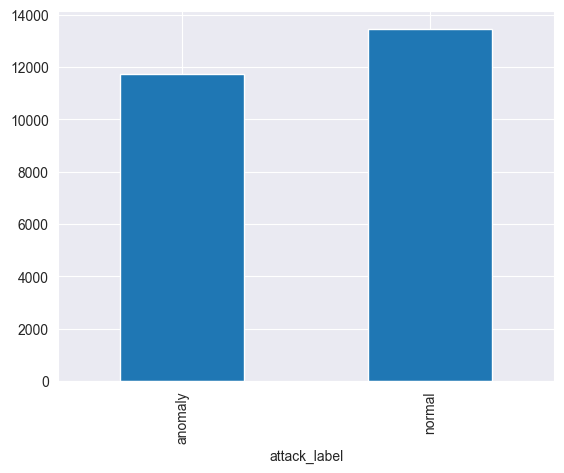

In [79]:
# How many Normal and Anomaly?
print(df.groupby(['attack_label'])['protocol_type'].count())
df.groupby(['attack_label'])['protocol_type'].count().plot(kind="bar")
plt.show()

In [80]:
#Data Visualization

In [81]:
def plot_bar_pie(df):
    protocol_counts = df['protocol_type'].value_counts()

    # Ensure enough colors for all categories
    num_protocols = len(protocol_counts)
    colors = sns.color_palette("pastel", num_protocols)  # Auto-generate enough colors

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Bar chart
    ax1.set_title('Distribution of Protocol Using Bar Plot')
    sns.barplot(x=protocol_counts.index, y=protocol_counts.values, hue=protocol_counts.index, 
                palette=colors, legend=False, ax=ax1)  # Assign hue to fix warning
    ax1.set_xlabel('Protocol_type')
    ax1.set_ylabel('Count')
    ax1.tick_params(axis='x', rotation=45)

    # Add labels on top of bars
    for i, value in enumerate(protocol_counts.values):
        y_coord = value + 0.05 * ax1.get_ylim()[1]  # Offset to avoid overlap
        ax1.text(i, y_coord, str(value), ha='center', va='bottom')

    # Pie chart
    ax2.set_title('Distribution of Protocol Using Pie Chart')
    ax2.pie(protocol_counts.values, labels=protocol_counts.index, colors=colors, autopct='%1.1f%%')
    ax2.axis('equal')

    plt.subplots_adjust(wspace=0.3)
    plt.show()

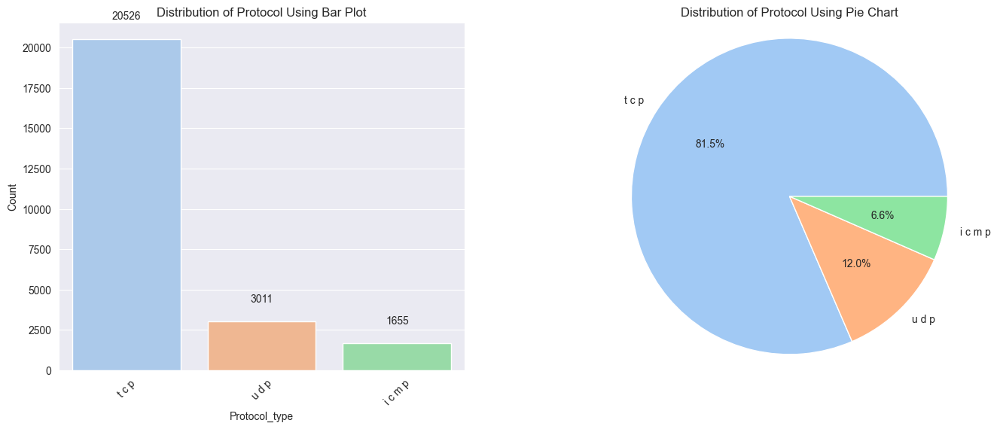

In [82]:
plot_bar_pie(df)

In [83]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_bar_pie(df):
    flag_counts = df['flag'].value_counts()

    # Use actual labels (no need to remap them)
    labels = flag_counts.index

    # Ensure enough colors for all categories
    colors = sns.color_palette("pastel", len(labels))  # Generate colors dynamically

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Bar chart
    ax1.set_title('Distribution of Abuse Using Bar Plot')
    sns.barplot(x=labels, y=flag_counts.values, hue=labels, palette=colors, legend=False, ax=ax1)  # ✅ FIXED

    ax1.set_xlabel(' flag')
    ax1.set_ylabel('Count')
    ax1.tick_params(axis='x', rotation=45)

    # Add labels on top of bars
    for i, value in enumerate(flag_counts.values):
        y_coord = value + 0.05 * ax1.get_ylim()[1]  # Offset to avoid overlap
        ax1.text(i, y_coord, str(value), ha='center', va='bottom')

    # Pie chart
    ax2.set_title('Distribution of Abuse Using Pie Plot')
    ax2.pie(flag_counts.values, labels=labels, colors=colors, autopct='%1.1f%%')
    ax2.axis('equal')

    plt.subplots_adjust(wspace=0.3)
    plt.show()


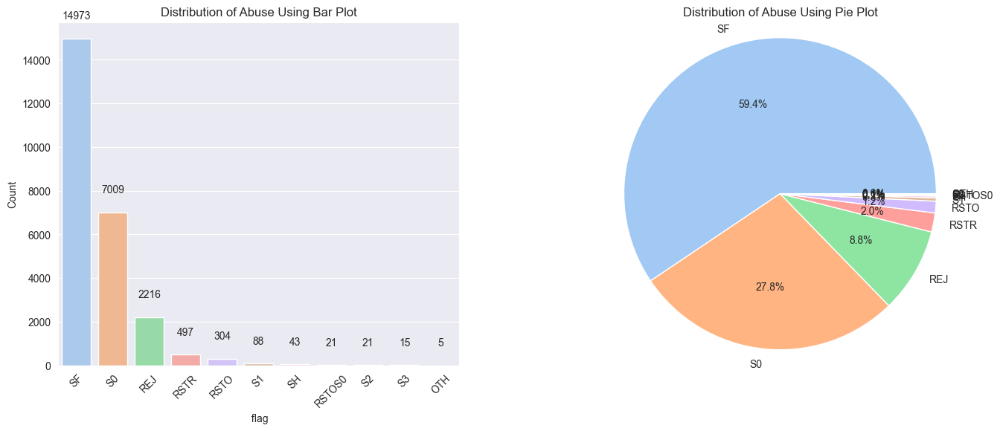

In [84]:
plot_bar_pie(df)

In [85]:
def cat_var(df):
    """ this function takes a dataframe df, and returs all categorical columns and their values"""
    for col in df.columns:
        if df[col].dtype == object:
            print (f"column name: {col}")
            print (f"........................................")
            print(f"{df[col].value_counts()}")
            print (f"........................................")

In [86]:
cat_var(df)

column name: protocol_type
........................................
protocol_type
t c p      20526
u d p       3011
i c m p     1655
Name: count, dtype: int64
........................................
column name: service
........................................
service
http         8003
private      4351
domain_u     1820
smtp         1449
ftp_data     1396
             ... 
urh_i           4
pm_dump         3
red_i           3
tim_i           2
http_8001       1
Name: count, Length: 66, dtype: int64
........................................
column name: flag
........................................
flag
SF        14973
S0         7009
REJ        2216
RSTR        497
RSTO        304
S1           88
SH           43
RSTOS0       21
S2           21
S3           15
OTH           5
Name: count, dtype: int64
........................................
column name: attack_label
........................................
attack_label
normal     13449
anomaly    11743
Name: count, dtype: int64
......

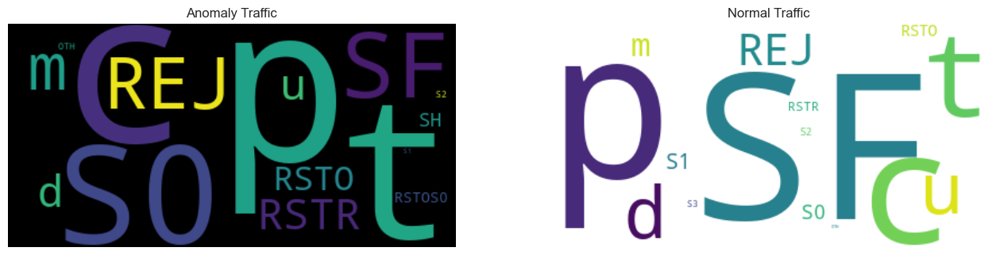

In [87]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Fix: Filter using "normal" and "anomaly" instead of 1 and 0
normal_df = df[df['attack_label'] == "normal"]  # Normal traffic
anomaly_df = df[df['attack_label'] == "anomaly"]  # Anomalous traffic

# Combine multiple text columns into a single string
normal_text = " ".join(normal_df[['protocol_type', 'flag']].dropna().astype(str).stack())
anomaly_text = " ".join(anomaly_df[['protocol_type', 'flag']].dropna().astype(str).stack())

# Ensure there is at least some text (to prevent empty WordCloud errors)
if not normal_text:
    normal_text = "NoData"
if not anomaly_text:
    anomaly_text = "NoData"

# Generate Word Clouds
normal_wc = WordCloud(collocations=False, background_color='white').generate(normal_text)
anomaly_wc = WordCloud(collocations=False, background_color='black').generate(anomaly_text)

# Plot Word Clouds
fig, axs = plt.subplots(1, 2, figsize=(16, 8))

axs[0].imshow(anomaly_wc, interpolation='bilinear')
axs[0].axis('off')
axs[0].set_title('Anomaly Traffic')

axs[1].imshow(normal_wc, interpolation='bilinear')  # ✅ Fixed: Showing normal traffic
axs[1].axis('off')
axs[1].set_title('Normal Traffic')

plt.show()


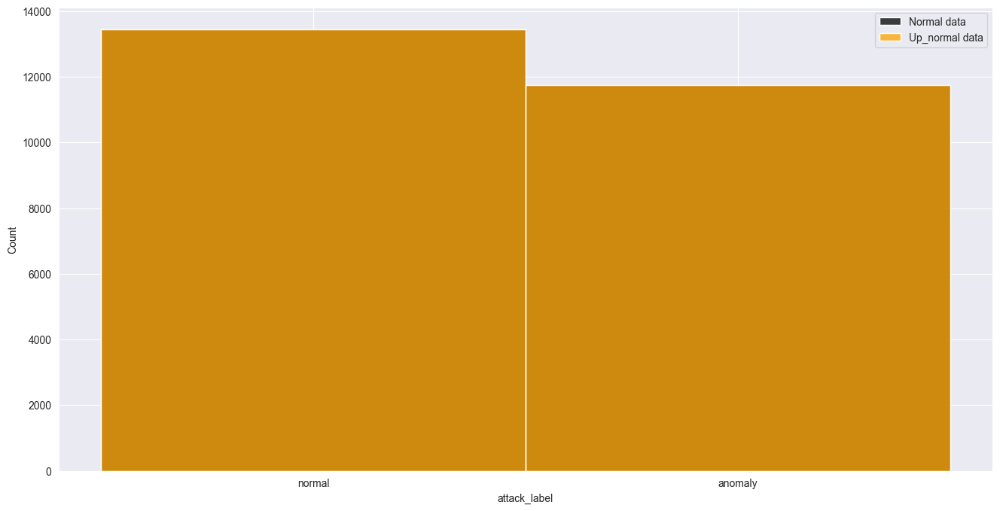

In [88]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16,8))
sns.set_style('darkgrid')
sns.histplot(data = df['attack_label'], color='black', legend=True)
sns.histplot(data = df['attack_label'], color = 'orange', legend=True)
plt.legend(['Normal data', 'Up_normal data'])
plt.show()

In [89]:
# visualizes the count of occurrences of each attack label

In [90]:
import plotly.express as px
labelChecker=df.groupby('attack_label').apply(lambda x:x['protocol_type'].count()).reset_index(name='Counts')
fig=px.bar(labelChecker,x='attack_label',y='Counts',color='Counts',title='Count of normal and anomaly by Label')
fig.show()

C:\Users\moham\AppData\Local\Temp\ipykernel_11244\3153128498.py:2: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [91]:
import plotly.express as px

# Fix filtering condition (use "normal" and "anomaly" instead of 0 and 1)
normal = len(df[df['attack_label'] == "normal"])
anomaly = len(df[df['attack_label'] == "anomaly"])

# Define labels and counts
Platform = ['Normal Traffic', 'Anomaly Traffic']
Count = [normal, anomaly]

# Create Pie Chart
fig = px.pie(
    names=Platform,
    values=Count,
    title='Traffic Distribution Using Pie Chart',
    color_discrete_sequence=px.colors.sequential.Agsunset
)

# Format Pie Chart
fig.update_traces(textposition='inside', textinfo='percent+label')

# Show the chart
fig.show()


In [92]:
# 1️⃣ Bar Chart - Distribution of Protocol
protocol_counts = df['protocol_type'].value_counts()
fig1 = px.bar(x=protocol_counts.index, y=protocol_counts.values, 
              title="Protocol Distribution", labels={'x':'Protocol', 'y':'Count'}, 
              color=protocol_counts.index)
fig1.show()

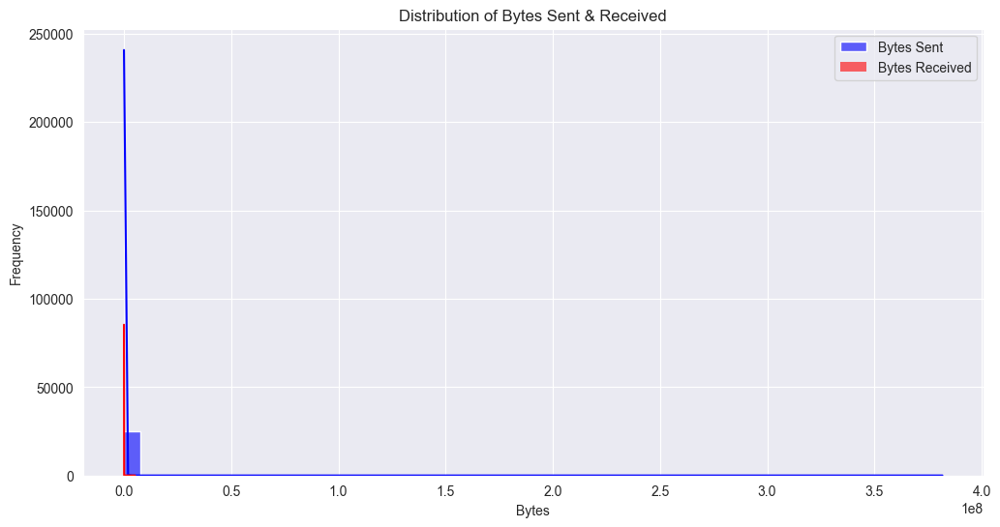

In [93]:
# 2️⃣ Histogram - Distribution of Bytes Sent & Received
plt.figure(figsize=(12,6))
sns.histplot(df['src_bytes'], bins=50, kde=True, color='blue', label="Bytes Sent", alpha=0.6)
sns.histplot(df['dst_bytes'], bins=50, kde=True, color='red', label="Bytes Received", alpha=0.6)
plt.title("Distribution of Bytes Sent & Received")
plt.xlabel("Bytes")
plt.ylabel("Frequency")
plt.legend()
plt.show()

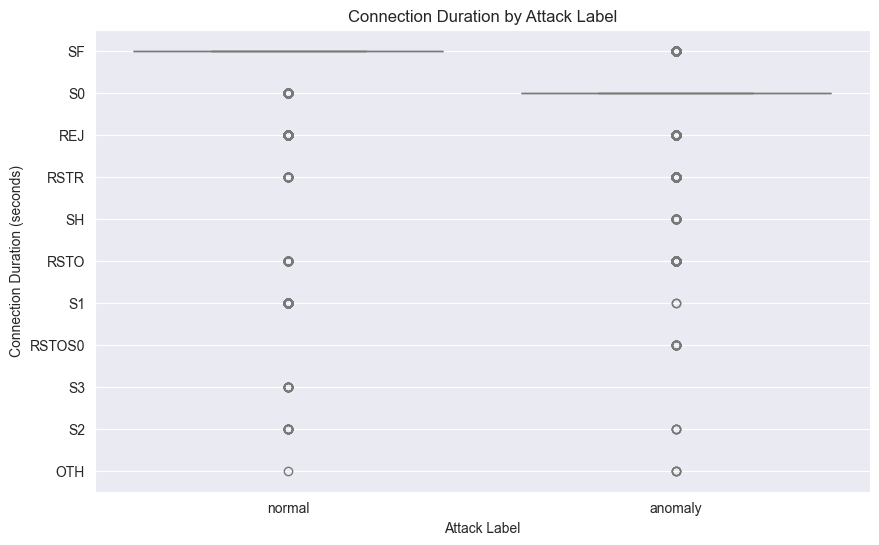

In [94]:
# 3️⃣ Box Plot - Connection Duration vs Attack Label
plt.figure(figsize=(10,6))
sns.boxplot(x=df['attack_label'], y=df['flag'], hue=df['attack_label'], 
            palette="coolwarm", legend=False)  # ✅ FIXED
plt.title("Connection Duration by Attack Label")
plt.xlabel("Attack Label")
plt.ylabel("Connection Duration (seconds)")
plt.show()

In [95]:
# 4️⃣ Pie Chart - Connection Status Distribution
connection_status_counts = df['flag'].value_counts()
fig2 = px.pie(names=connection_status_counts.index, values=connection_status_counts.values, 
              title="Connection Status Distribution", color_discrete_sequence=px.colors.sequential.Agsunset)
fig2.show()

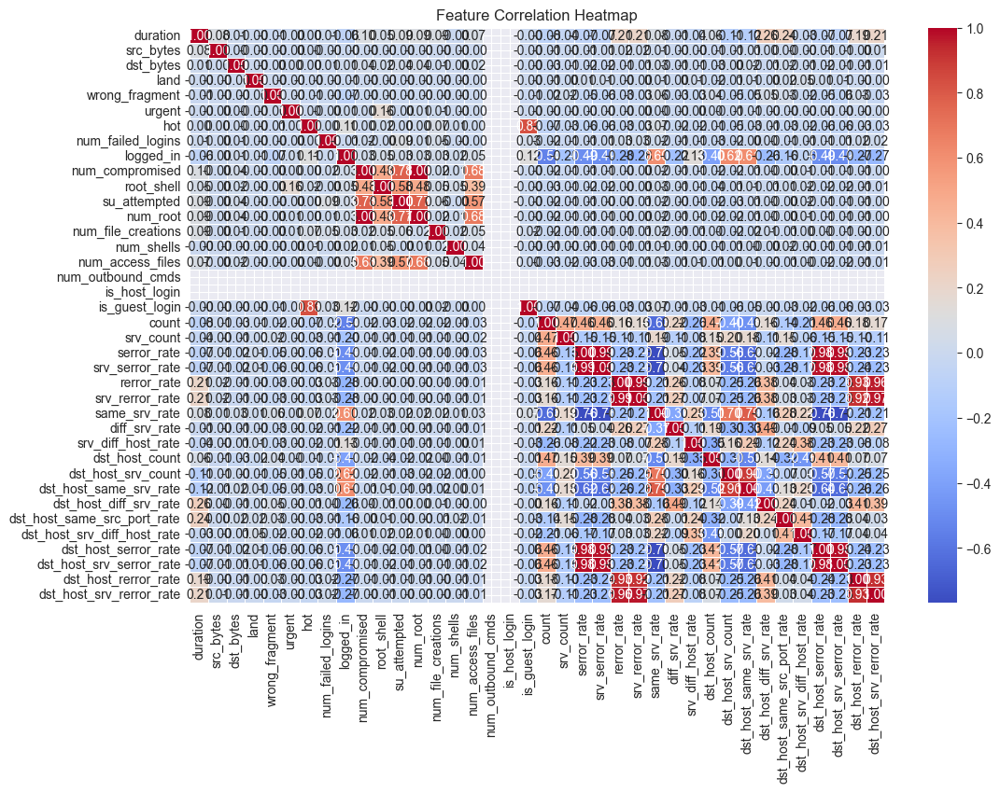

In [96]:
# 5️⃣ Heatmap - Correlation Matrix of Numerical Features
plt.figure(figsize=(12,8))
corr_matrix = df.select_dtypes(include=[np.number]).corr()
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Feature Correlation Heatmap")
plt.show()

In [97]:
# # Calculating the correlation matrix for numeric columns
# correlation_matrix = df.select_dtypes(include=np.number).corr()

# # Displaying the correlation matrix
# print(f"Correlation Matrix:\n {correlation_matrix}")

In [98]:
# Creating training and tests

In [99]:
df["attack_label"].value_counts(normalize=True)

attack_label
normal     0.53386
anomaly    0.46614
Name: proportion, dtype: float64

In [100]:
print(df.columns)


Index(['duration', 'protocol_type', 'service', 'flag', 'src_bytes',
       'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'hot',
       'num_failed_logins', 'logged_in', 'num_compromised', 'root_shell',
       'su_attempted', 'num_root', 'num_file_creations', 'num_shells',
       'num_access_files', 'num_outbound_cmds', 'is_host_login',
       'is_guest_login', 'count', 'srv_count', 'serror_rate',
       'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate',
       'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count',
       'dst_host_srv_count', 'dst_host_same_srv_rate',
       'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'dst_host_rerror_rate',
       'dst_host_srv_rerror_rate', 'attack_label'],
      dtype='object')


In [101]:
# # Define top 20 features based on Random Forest importance
# feature_columns = [
#     'src_bytes', 'dst_bytes', 'same_srv_rate', 'flag', 'dst_host_srv_count',
#     'serror_rate', 'srv_serror_rate', 'service', 'dst_host_serror_rate',
#     'dst_host_same_srv_rate', 'count', 'dst_host_rerror_rate', 'rerror_rate',
#     'logged_in', 'protocol_type', 'srv_count', 'diff_srv_rate', 'srv_rerror_rate',
#     'dst_host_diff_srv_rate', 'dst_host_srv_serror_rate'
# ]

# # ✅ Use encoded label column
# target_column = 'attack_label'

# # Prepare X and y
# X = df[feature_columns]
# y = df[target_column]


In [102]:
# from sklearn.preprocessing import LabelEncoder
# import joblib
# import numpy as np

# # === Define categorical columns
# categorical_cols = ['protocol_type', 'service', 'flag']
# label_encoders = {}

# # === Encode categorical columns and save encoders
# for col in categorical_cols:
#     le = LabelEncoder()
#     le.fit(df[col])
#     df[col] = le.transform(df[col])
#     label_encoders[col] = le
#     joblib.dump(le, f"{col}_encoder.pkl")  # e.g., protocol_type_encoder.pkl

# # === Custom encode target label column (attack_label)
# label_map = {'normal': 0, 'anomaly': 1}  # 👈 Custom order
# df['label'] = df['attack_label'].map(label_map)  # 👈 Apply mapping
# label_le = LabelEncoder()
# label_le.classes_ = np.array(['normal', 'anomaly'])  # 👈 Set correct order
# joblib.dump(label_le, "label_encoder.pkl")  # Save label encoder

# # ✅ Confirm
# print(f"Label classes: {label_le.classes_}")
# print(df['label'].value_counts())  # Optional: show label distribution
# print("✅ Encoders fitted and saved with normal=0 and anomaly=1")


In [103]:
# #Split your data into training and testing sets with stratification

# from sklearn.model_selection import train_test_split

# X_train, X_test, y_train, y_test = train_test_split(
#     X, y, test_size=0.2, stratify=y, random_state=42
# )


In [104]:
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import LabelEncoder
# from imblearn.over_sampling import SMOTE
# import joblib
# import pandas as pd

# # === 1. Load your dataset
# df = pd.read_csv('D:\JUST LESSONS\defense\ml part\interface part\dataset\Train_data_Dataset.csv', encoding='latin')

# # === 2. Define categorical columns
# categorical_cols = ['protocol_type', 'service', 'flag']
# label_encoders = {}

# # === 3. Encode categorical features
# for col in categorical_cols:
#     le = LabelEncoder()
#     df[col] = le.fit_transform(df[col])
#     label_encoders[col] = le
#     joblib.dump(le, f"{col}_encoder.pkl")  # Save encoder

# # === 4. Encode target column
# # === 4. Encode target column with custom mapping
# label_map = {'normal': 0, 'anomaly': 1}
# df['label'] = df['attack_label'].map(label_map)

# # Save correct label encoder for future decoding
# label_le = LabelEncoder()
# label_le.classes_ = np.array(['normal', 'anomaly'])  # manual order
# joblib.dump(label_le, "label_encoder.pkl")
# print("Label classes:", label_le.classes_)


# # === 5. Define feature columns (Top 20 from RF)
# feature_columns = [
#     'src_bytes', 'dst_bytes', 'same_srv_rate', 'flag', 'dst_host_srv_count',
#     'serror_rate', 'srv_serror_rate', 'service', 'dst_host_serror_rate',
#     'dst_host_same_srv_rate', 'count', 'dst_host_rerror_rate', 'rerror_rate',
#     'logged_in', 'protocol_type', 'srv_count', 'diff_srv_rate', 'srv_rerror_rate',
#     'dst_host_diff_srv_rate', 'dst_host_srv_serror_rate'
# ]

# # === 6. Prepare X and y
# X = df[feature_columns]
# y = df['label']  # already numeric

# # === 7. Split dataset
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # === 8. Apply SMOTE to balance the training data
# smote = SMOTE(random_state=42)
# X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)

# print("✅ SMOTE applied successfully!")
# print("Before SMOTE:", y_train.value_counts().to_dict())
# print("After SMOTE:", y_train_balanced.value_counts().to_dict())


In [105]:
# Scale Feature

In [106]:
# from sklearn.model_selection import train_test_split

# X_train, X_test, y_train, y_test = train_test_split(
#     X, y, test_size=0.2, random_state=42, stratify=y
# )

# # Step 2: Apply SMOTE
# smote = SMOTE(random_state=42)
# X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)

# # Step 3: Scale numeric columns
# numeric_cols = X_train_balanced.select_dtypes(include=['int64', 'float64']).columns.tolist()
# scaler = StandardScaler()

# X_train_scaled = X_train_balanced.copy()
# X_train_scaled[numeric_cols] = scaler.fit_transform(X_train_balanced[numeric_cols])

# X_test_scaled = X_test.copy()
# X_test_scaled[numeric_cols] = scaler.transform(X_test[numeric_cols])



In [107]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from imblearn.over_sampling import SMOTE
import joblib

# === Step 1: Load Dataset
df = pd.read_csv("D:/next gen thesis/Test interface part/dataset/Train_data_Dataset.csv", encoding='latin')

# === Step 2: Define categorical columns and initialize encoder storage
categorical_cols = ['protocol_type', 'service', 'flag']
label_encoders = {}

# === Step 3: Save original encoders BEFORE transforming columns
for col in categorical_cols:
    df[col] = df[col].astype(str)  # Ensure string format
    le = LabelEncoder()
    le.fit(df[col])  # Fit on original string values
    joblib.dump(le, f"{col}_encoder.pkl")  # ✅ Save BEFORE transforming
    df[col] = le.transform(df[col])  # Transform to integer values for model
    label_encoders[col] = le
    print(f"✅ {col} classes ({len(le.classes_)}): {le.classes_[:5]}{'...' if len(le.classes_) > 5 else ''}")

# === Step 4: Encode the label manually and save
label_map = {'normal': 0, 'anomaly': 1}
df['label'] = df['attack_label'].map(label_map)

label_le = LabelEncoder()
label_le.classes_ = np.array(['normal', 'anomaly'])  # string classes preserved
joblib.dump(label_le, "label_encoder.pkl")
print("✅ Label encoder saved with classes:", label_le.classes_)

# === Step 5: Select Features for Model
feature_columns = [
'protocol_type','service','flag','src_bytes','dst_bytes','logged_in','count',
'srv_count','serror_rate','rerror_rate','srv_rerror_rate','same_srv_rate','diff_srv_rate',
'dst_host_srv_count','dst_host_serror_rate' 
]

X = df[feature_columns]
y = df['label']

# === Step 6: Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# === Step 7: Balance the Training Set with SMOTE
smote = SMOTE(random_state=42)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)

print("\n✅ SMOTE applied successfully!")
print("➡️ Before SMOTE:", y_train.value_counts().to_dict())
print("➡️ After SMOTE:", y_train_balanced.value_counts().to_dict())

# === Step 8: Scale the Features (excluding label-encoded categorical cols)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_balanced)
X_test_scaled = scaler.transform(X_test)

# === Step 9: Save Scaler for Inference Use
joblib.dump(scaler, "scaler.pkl")
print("✅ Scaler saved. Ready for model training.")


✅ protocol_type classes (3): ['icmp' 'tcp' 'udp']
✅ service classes (66): ['IRC' 'X11' 'Z39_50' 'auth' 'bgp']...
✅ flag classes (11): ['OTH' 'REJ' 'RSTO' 'RSTOS0' 'RSTR']...
✅ Label encoder saved with classes: ['normal' 'anomaly']

✅ SMOTE applied successfully!
➡️ Before SMOTE: {0: 10759, 1: 9394}
➡️ After SMOTE: {0: 10759, 1: 10759}
✅ Scaler saved. Ready for model training.


In [108]:
print("X_train_balanced shape:", X_train_balanced.shape)
print("y_train_balanced shape:", y_train_balanced.shape)
print("X_train_scaled shape:", X_train_scaled.shape)


X_train_balanced shape: (21518, 15)
y_train_balanced shape: (21518,)
X_train_scaled shape: (21518, 15)


## BUILDING MECHINE LEARNING MODELS

In [109]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix

def getConfusionMatrix(pred, true, title):
    cf_matrix = confusion_matrix(true, pred)

    # Ensure binary classification matrix shape
    if cf_matrix.shape != (2, 2):
        raise ValueError("Confusion matrix is not binary (2x2). Check your labels.")

    group_names = ["TN", "FP", "FN", "TP"]
    group_counts = ["{0:0.0f}".format(val) for val in cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(val) for val in cf_matrix.flatten() / np.sum(cf_matrix)]

    labels = [f"{name}\n{count}\n{percent}" for name, count, percent in zip(group_names, group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues", cbar=False)
    plt.title("Confusion Matrix - " + title, fontsize=16, weight="bold")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.tight_layout()
    plt.savefig(f"{title}.png")
    plt.show()


In [110]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

def get_roc(y_test, y_pred, pos_label='normal'):
    """
    Plots ROC curve and computes AUC score.

    Parameters:
    y_test (array-like): True binary labels (can be strings like 'normal', 'anomaly').
    y_pred (array-like): Predicted scores (probabilities) for positive class.
    pos_label (str or int): Label considered positive for ROC calculation.
    """
    fpr, tpr, _ = roc_curve(y_test, y_pred, pos_label=pos_label)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(8,6))
    lw = 2
    plt.plot(fpr, tpr, color='darkorange',
             lw=lw, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()


## 1 Rondom Forest Model

🎯 Confusion Matrix:
[[2684    6]
 [  14 2335]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00      2690
           1       1.00      0.99      1.00      2349

    accuracy                           1.00      5039
   macro avg       1.00      1.00      1.00      5039
weighted avg       1.00      1.00      1.00      5039



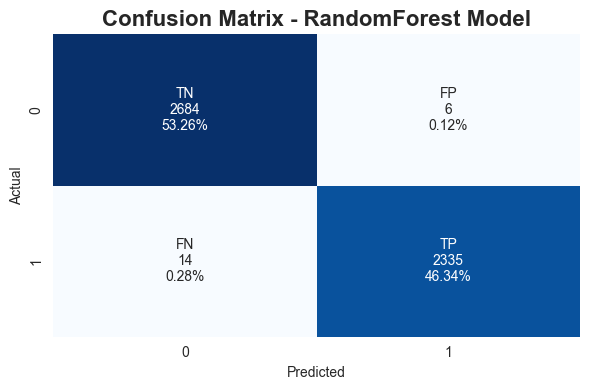

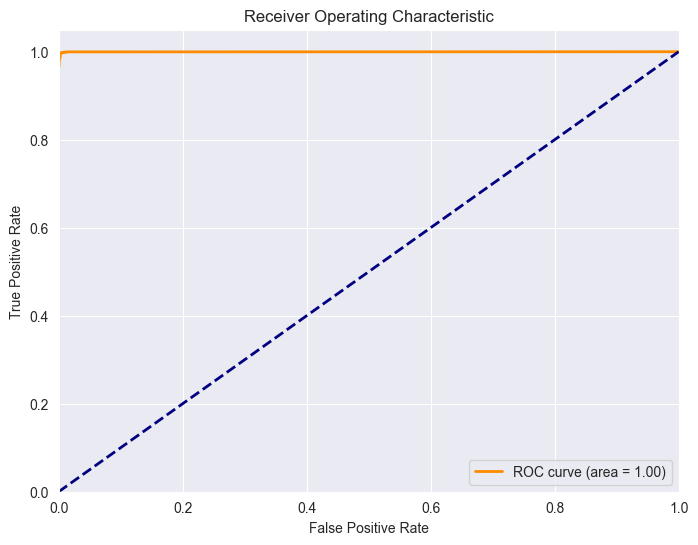

In [111]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# If you're running this in a separate script, load the preprocessed variables:
# X_train_scaled, X_test_scaled, y_train_balanced, y_test

# Example: If you've saved and want to load them, do this:
# import pandas as pd
# X_train_scaled = pd.read_pickle("X_train_scaled.pkl")
# X_test_scaled = pd.read_pickle("X_test_scaled.pkl")
# y_train_balanced = pd.read_pickle("y_train_balanced.pkl")
# y_test = pd.read_pickle("y_test.pkl")

# 1. Train the RandomForest model
rf = RandomForestClassifier(n_estimators=600, random_state=42)
rf.fit(X_train_scaled, y_train_balanced)

# 2. Predict
predict_rf = rf.predict(X_test_scaled)

# 3. Evaluate
print("🎯 Confusion Matrix:")
print(confusion_matrix(y_test, predict_rf))

print("\n📊 Classification Report:")
print(classification_report(y_test, predict_rf))

# 4. Visualize (Optional if functions are defined)
try:
    y_rf_scores = rf.predict_proba(X_test_scaled)[:, 0]  # Class 0 = normal
    getConfusionMatrix(pred=predict_rf, true=y_test, title='RandomForest Model')
    get_roc(y_test, y_rf_scores, pos_label=0)
except:
    print("ℹ️ Skipped visualization: `getConfusionMatrix` or `get_roc` not found")



## 2 xgboost model

🎯 XGBoost - Confusion Matrix:
[[2685    5]
 [  12 2337]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2690
           1       1.00      0.99      1.00      2349

    accuracy                           1.00      5039
   macro avg       1.00      1.00      1.00      5039
weighted avg       1.00      1.00      1.00      5039



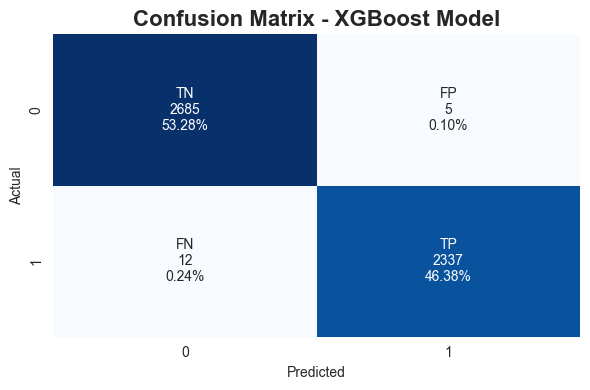

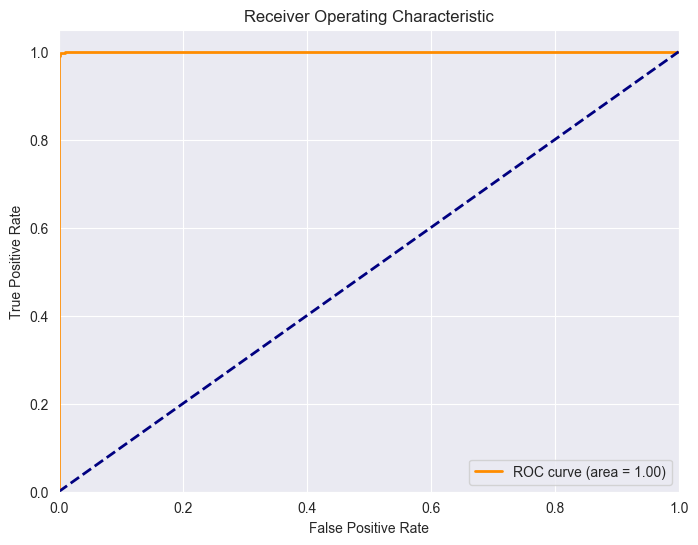

In [112]:
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Train the XGBoost model
xgb = XGBClassifier(random_state=22, learning_rate=0.9, eval_metric='logloss')
xgb.fit(X_train_scaled, y_train_balanced)

# 2. Predict
predict_xgb = xgb.predict(X_test_scaled)

# 3. Evaluate
print("🎯 XGBoost - Confusion Matrix:")
print(confusion_matrix(y_test, predict_xgb))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_xgb))

# 4. Visualize (Optional)
try:
    y_scores = xgb.predict_proba(X_test_scaled)[:, 1]  # class 1 = anomaly
    getConfusionMatrix(pred=predict_xgb, true=y_test, title='XGBoost Model')
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped visualization: `getConfusionMatrix` or `get_roc` not found")



## 3 LinearSVC model

🧠 LinearSVC - Confusion Matrix:
[[2539  151]
 [ 186 2163]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      2690
           1       0.93      0.92      0.93      2349

    accuracy                           0.93      5039
   macro avg       0.93      0.93      0.93      5039
weighted avg       0.93      0.93      0.93      5039



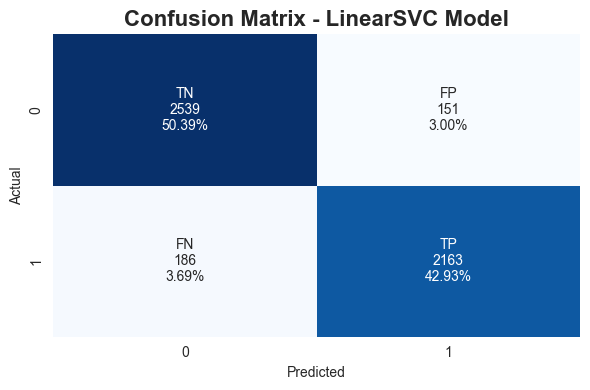

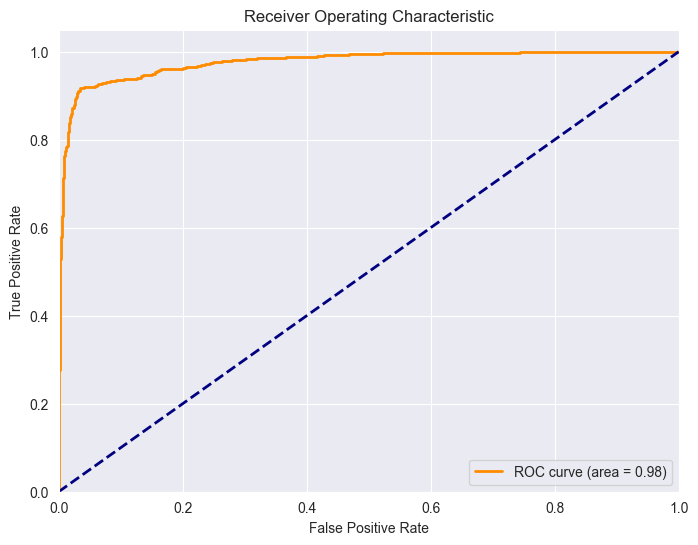

In [113]:
from sklearn.svm import LinearSVC
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Train LinearSVC model
svc = LinearSVC(random_state=42, max_iter=10000)
svc.fit(X_train_scaled, y_train_balanced)

# 2. Predict
predict_svc = svc.predict(X_test_scaled)

# 3. Evaluate
print("🧠 LinearSVC - Confusion Matrix:")
print(confusion_matrix(y_test, predict_svc))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_svc))

# 4. Visualize (Optional)
try:
    getConfusionMatrix(pred=predict_svc, true=y_test, title='LinearSVC Model')
    y_scores = svc.decision_function(X_test_scaled)  # Not probabilities, just distance
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped visualization: `getConfusionMatrix` or `get_roc` not found")



## 4 LogisticRegression model

🧮 Logistic Regression - Confusion Matrix:
[[2531  159]
 [ 194 2155]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.94      0.93      2690
           1       0.93      0.92      0.92      2349

    accuracy                           0.93      5039
   macro avg       0.93      0.93      0.93      5039
weighted avg       0.93      0.93      0.93      5039



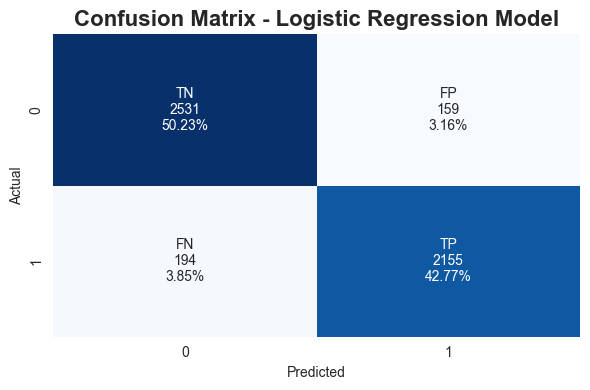

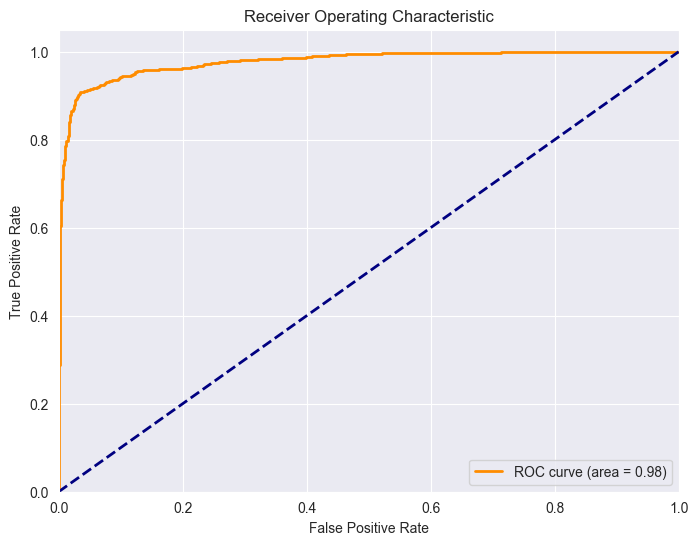

In [114]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Initialize Logistic Regression
logreg = LogisticRegression(random_state=42, max_iter=1000)

# 2. Train on balanced and scaled data
logreg.fit(X_train_scaled, y_train_balanced)

# 3. Predict on test data
predict_logr = logreg.predict(X_test_scaled)

# 4. Evaluation
print("🧮 Logistic Regression - Confusion Matrix:")
print(confusion_matrix(y_test, predict_logr))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_logr))

# 5. Visualizations
try:
    getConfusionMatrix(pred=predict_logr, true=y_test, title='Logistic Regression Model')
    y_scores = logreg.predict_proba(X_test_scaled)[:, 1]  # Class 1 (anomaly)
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped visualization: `getConfusionMatrix` or `get_roc` not found")



## 5 LinearSVC

🧮 SVM - Confusion Matrix:
[[2539  151]
 [ 186 2163]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      2690
           1       0.93      0.92      0.93      2349

    accuracy                           0.93      5039
   macro avg       0.93      0.93      0.93      5039
weighted avg       0.93      0.93      0.93      5039



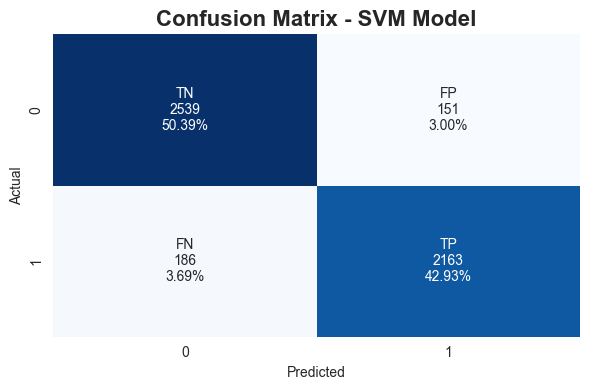

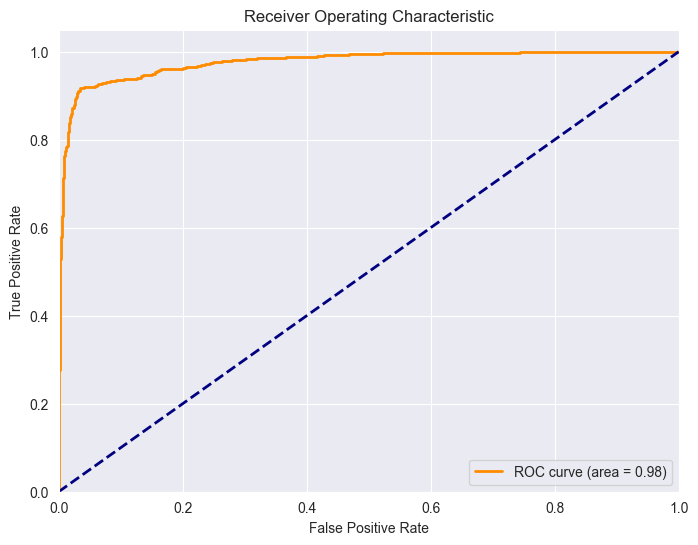

In [115]:
from sklearn.svm import LinearSVC
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Initialize LinearSVC
lin_clf = LinearSVC(random_state=42, max_iter=10000)

# 2. Train the model
lin_clf.fit(X_train_scaled, y_train_balanced)

# 3. Predict
predict_svm = lin_clf.predict(X_test_scaled)

# 4. Evaluation
print("🧮 SVM - Confusion Matrix:")
print(confusion_matrix(y_test, predict_svm))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_svm))

# 5. Visualizations
try:
    getConfusionMatrix(pred=predict_svm, true=y_test, title='SVM Model')
    y_scores = lin_clf.decision_function(X_test_scaled)
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped visualization: `getConfusionMatrix` or `get_roc` not found")



## 6 DecisionTreeClassifier

🧮 Decision Tree - Confusion Matrix:
[[2683    7]
 [  18 2331]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00      2690
           1       1.00      0.99      0.99      2349

    accuracy                           1.00      5039
   macro avg       1.00      0.99      1.00      5039
weighted avg       1.00      1.00      1.00      5039



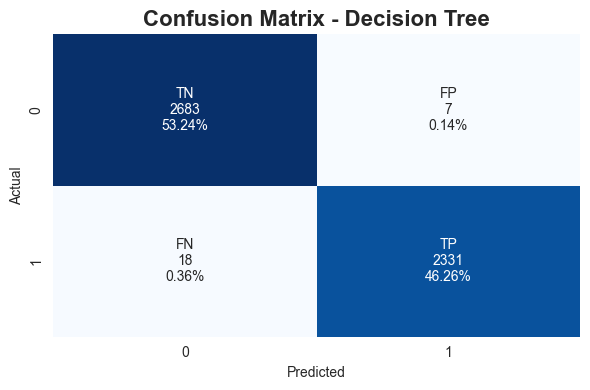

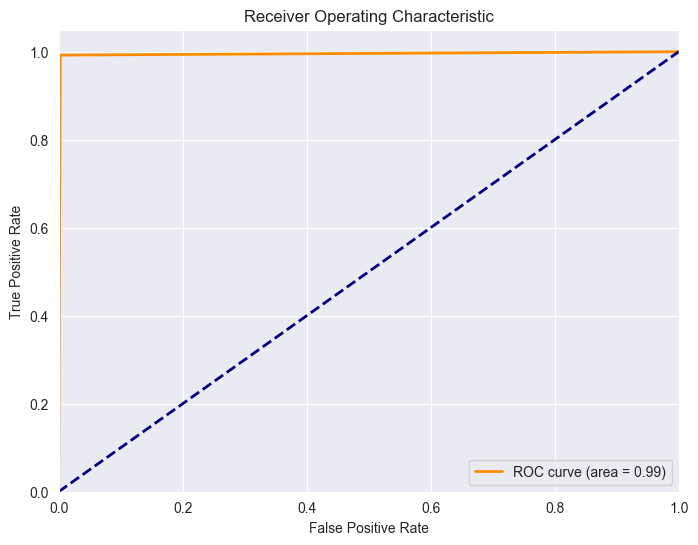

In [116]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Initialize Decision Tree classifier
classifier_dt = DecisionTreeClassifier(criterion='entropy', random_state=42)

# 2. Train on scaled, balanced training data
classifier_dt.fit(X_train_scaled, y_train_balanced)

# 3. Predict on test data
predict_dt = classifier_dt.predict(X_test_scaled)

# 4. Evaluation
print("🧮 Decision Tree - Confusion Matrix:")
print(confusion_matrix(y_test, predict_dt))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_dt))

# 5. Visualize results
try:
    getConfusionMatrix(pred=predict_dt, true=y_test, title='Decision Tree')
    y_scores = classifier_dt.predict_proba(X_test_scaled)[:, 1]
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped visualization: getConfusionMatrix or get_roc not defined")



## 7 KNeighborsClassifier

🧮 KNN - Confusion Matrix:
[[2637   53]
 [  41 2308]]

📊 Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2690
           1       0.98      0.98      0.98      2349

    accuracy                           0.98      5039
   macro avg       0.98      0.98      0.98      5039
weighted avg       0.98      0.98      0.98      5039



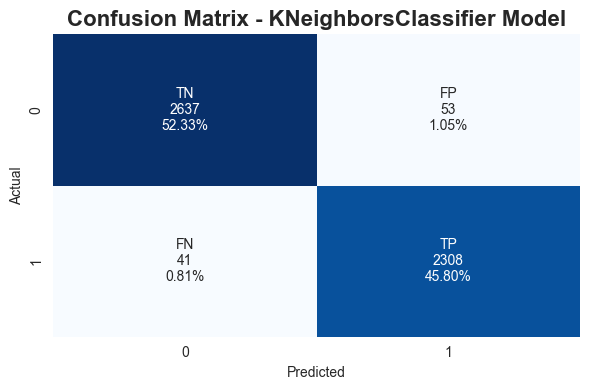

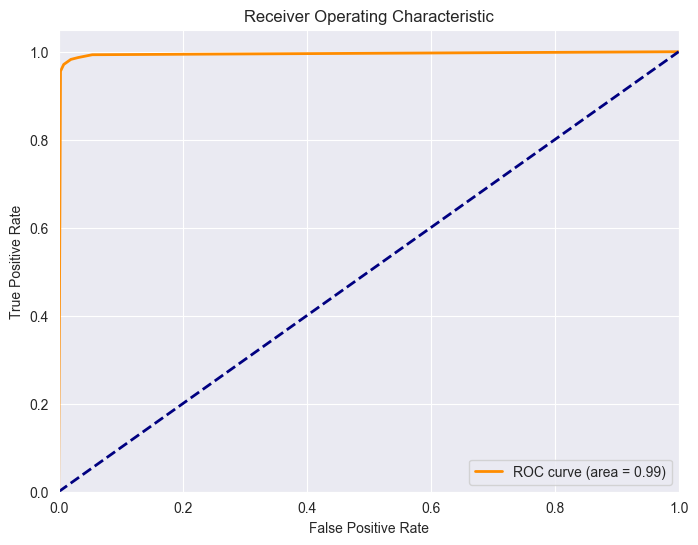

In [117]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# 1. Initialize KNN Classifier (Euclidean distance by default: p=2)
classifier_knn = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2)

# 2. Train on scaled & balanced training data
classifier_knn.fit(X_train_scaled, y_train_balanced)

# 3. Predict on test data
predict_knn = classifier_knn.predict(X_test_scaled)

# 4. Evaluation
print("🧮 KNN - Confusion Matrix:")
print(confusion_matrix(y_test, predict_knn))
print("\n📊 Classification Report:")
print(classification_report(y_test, predict_knn))

# 5. Visualization
try:
    getConfusionMatrix(pred=predict_knn, true=y_test, title='KNeighborsClassifier Model')
    y_scores = classifier_knn.predict_proba(X_test_scaled)[:, 1]
    get_roc(y_test, y_scores, pos_label=1)
except:
    print("ℹ️ Skipped ROC or Confusion Matrix: Function not defined or no predict_proba support")


In [118]:
from sklearn.metrics import accuracy_score

# ✅ Directly compute accuracy since y_test and all predictions are already numeric
rf_score   = accuracy_score(y_test, predict_rf)
xgb_score  = accuracy_score(y_test, predict_xgb)
svc_score  = accuracy_score(y_test, predict_svc)
lr_score   = accuracy_score(y_test, predict_logr)
svm_score  = accuracy_score(y_test, predict_svm)
dt_score   = accuracy_score(y_test, predict_dt)
knn_score  = accuracy_score(y_test, predict_knn)

# ✅ Print the comparison table
print("\n       📊 MACHINE LEARNING MODEL ACCURACY COMPARISON         ")
print("------------------------------------------------------------")
print(f'🌲 Random Forest Accuracy            : {rf_score * 100:.2f}%')
print(f'⚡ XGBoost Accuracy                  : {xgb_score * 100:.2f}%')
print(f'📏 LinearSVC Accuracy               : {svc_score * 100:.2f}%')
print(f'📈 Logistic Regression Accuracy      : {lr_score * 100:.2f}%')
print(f'🌀 SVM Accuracy                      : {svm_score * 100:.2f}%')
print(f'🌳 Decision Tree Accuracy            : {dt_score * 100:.2f}%')
print(f'👣 KNeighbors Classifier Accuracy    : {knn_score * 100:.2f}%')



       📊 MACHINE LEARNING MODEL ACCURACY COMPARISON         
------------------------------------------------------------
🌲 Random Forest Accuracy            : 99.60%
⚡ XGBoost Accuracy                  : 99.66%
📏 LinearSVC Accuracy               : 93.31%
📈 Logistic Regression Accuracy      : 92.99%
🌀 SVM Accuracy                      : 93.31%
🌳 Decision Tree Accuracy            : 99.50%
👣 KNeighbors Classifier Accuracy    : 98.13%


In [119]:
#Saving Model

In [120]:
from xgboost import XGBClassifier
import joblib

joblib.dump(xgb, "xgboost_best_model.pkl")
print("✅ XGBoost best model saved successfully")

✅ XGBoost best model saved successfully


In [121]:
import joblib
import numpy as np
import pandas as pd

# === Step 1: Load saved encoders and scaler
protocol_encoder = joblib.load("protocol_type_encoder.pkl")
service_encoder = joblib.load("service_encoder.pkl")
flag_encoder = joblib.load("flag_encoder.pkl")
label_encoder = joblib.load("label_encoder.pkl")
scaler = joblib.load("scaler.pkl")

print("✅ Loaded all encoders and scaler successfully.\n")

# === Step 2: Show encoder class info for verification
print("Protocol classes:", protocol_encoder.classes_)
print("Service classes (total):", len(service_encoder.classes_))
print("Flag classes:", flag_encoder.classes_)
print("Label classes:", label_encoder.classes_)

# === Step 3: Example raw input (15 features only)
raw_input = {
    'protocol_type': 'tcp',
    'service': 'http',
    'flag': 'SF',
    'src_bytes': 181,
    'dst_bytes': 5450,
    'logged_in': 1,
    'count': 255,
    'srv_count': 100,
    'serror_rate': 0.0,
    'rerror_rate': 0.0,
    'srv_rerror_rate': 0.0,
    'same_srv_rate': 0.9,
    'diff_srv_rate': 0.01,
    'dst_host_srv_count': 25,
    'dst_host_serror_rate': 0.0
}

# === Step 4: Encode categorical inputs
encoded_protocol = protocol_encoder.transform([raw_input['protocol_type']])[0]
encoded_service = service_encoder.transform([raw_input['service']])[0]
encoded_flag = flag_encoder.transform([raw_input['flag']])[0]

# === Step 5: Create feature vector in the correct order (15 features)
input_features = {
    'protocol_type': encoded_protocol,
    'service': encoded_service,
    'flag': encoded_flag,
    'src_bytes': raw_input['src_bytes'],
    'dst_bytes': raw_input['dst_bytes'],
    'logged_in': raw_input['logged_in'],
    'count': raw_input['count'],
    'srv_count': raw_input['srv_count'],
    'serror_rate': raw_input['serror_rate'],
    'rerror_rate': raw_input['rerror_rate'],
    'srv_rerror_rate': raw_input['srv_rerror_rate'],
    'same_srv_rate': raw_input['same_srv_rate'],
    'diff_srv_rate': raw_input['diff_srv_rate'],
    'dst_host_srv_count': raw_input['dst_host_srv_count'],
    'dst_host_serror_rate': raw_input['dst_host_serror_rate']
}

# === Step 6: Convert to DataFrame
input_df = pd.DataFrame([input_features])

# === Step 7: Scale the input
scaled_input = scaler.transform(input_df)

# === Step 8: Load model and predict
model = joblib.load("xgboost_best_model.pkl")
prediction = model.predict(scaled_input)[0]
prediction_label = label_encoder.inverse_transform([prediction])[0]

# === Step 9: Output result
print("\n🔍 Prediction Result:")
print("Encoded prediction:", prediction)
print("Decoded prediction:", prediction_label)


✅ Loaded all encoders and scaler successfully.

Protocol classes: ['icmp' 'tcp' 'udp']
Service classes (total): 66
Flag classes: ['OTH' 'REJ' 'RSTO' 'RSTOS0' 'RSTR' 'S0' 'S1' 'S2' 'S3' 'SF' 'SH']
Label classes: ['normal' 'anomaly']

🔍 Prediction Result:
Encoded prediction: 0
Decoded prediction: normal


In [122]:
print(protocol_encoder.classes_)  # should show ['icmp', 'tcp', 'udp']


['icmp' 'tcp' 'udp']


In [123]:
import joblib
import numpy as np
import pandas as pd

# === Step 1: Load encoders, scaler, and model
protocol_encoder = joblib.load("protocol_type_encoder.pkl")
service_encoder = joblib.load("service_encoder.pkl")
flag_encoder = joblib.load("flag_encoder.pkl")
label_encoder = joblib.load("label_encoder.pkl")
scaler = joblib.load("scaler.pkl")
model = joblib.load("xgboost_best_model.pkl")  # 🔁 Replace with your model if needed

print("✅ Loaded all encoders, scaler, and model successfully.\n")

# === Step 2: Show class info (optional)
print("Protocol classes:", protocol_encoder.classes_)
print("Service classes (total):", len(service_encoder.classes_))
print("Flag classes:", flag_encoder.classes_)
print("Label classes:", label_encoder.classes_)

# === Step 3: Anomalous input (with only 15 features)
raw_input = {
    'protocol_type': 'icmp',
    'service': 'eco_i',
    'flag': 'S0',
    'src_bytes': 0,
    'dst_bytes': 0,
    'logged_in': 0,
    'count': 5,
    'srv_count': 2,
    'serror_rate': 1.0,
    'rerror_rate': 0.8,
    'srv_rerror_rate': 0.8,
    'same_srv_rate': 0.0,
    'diff_srv_rate': 0.9,
    'dst_host_srv_count': 1,
    'dst_host_serror_rate': 1.0
}

# === Step 4: Encode categorical fields
encoded_protocol = protocol_encoder.transform([raw_input['protocol_type']])[0]
encoded_service = service_encoder.transform([raw_input['service']])[0]
encoded_flag = flag_encoder.transform([raw_input['flag']])[0]

# === Step 5: Create ordered input dictionary with only 15 features
input_features = {
    'protocol_type': encoded_protocol,
    'service': encoded_service,
    'flag': encoded_flag,
    'src_bytes': raw_input['src_bytes'],
    'dst_bytes': raw_input['dst_bytes'],
    'logged_in': raw_input['logged_in'],
    'count': raw_input['count'],
    'srv_count': raw_input['srv_count'],
    'serror_rate': raw_input['serror_rate'],
    'rerror_rate': raw_input['rerror_rate'],
    'srv_rerror_rate': raw_input['srv_rerror_rate'],
    'same_srv_rate': raw_input['same_srv_rate'],
    'diff_srv_rate': raw_input['diff_srv_rate'],
    'dst_host_srv_count': raw_input['dst_host_srv_count'],
    'dst_host_serror_rate': raw_input['dst_host_serror_rate']
}

# === Step 6: Convert to DataFrame
input_df = pd.DataFrame([input_features])

# === Step 7: Scale input
scaled_input = scaler.transform(input_df)

# === Step 8: Predict
prediction = model.predict(scaled_input)[0]
prediction_label = label_encoder.inverse_transform([prediction])[0]

# === Step 9: Output result
print("\n🔍 Prediction Result:")
print("Encoded prediction:", prediction)
print("Decoded prediction:", prediction_label)


✅ Loaded all encoders, scaler, and model successfully.

Protocol classes: ['icmp' 'tcp' 'udp']
Service classes (total): 66
Flag classes: ['OTH' 'REJ' 'RSTO' 'RSTOS0' 'RSTR' 'S0' 'S1' 'S2' 'S3' 'SF' 'SH']
Label classes: ['normal' 'anomaly']

🔍 Prediction Result:
Encoded prediction: 1
Decoded prediction: anomaly


In [124]:
# ✅ Imports
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# ✅ Predictions (assume you already have them)
# Example:
# predict_rf   = rf_model.predict(X_test)
# predict_xgb  = xgb_model.predict(X_test)
# predict_svc  = svc_model.predict(X_test)
# predict_logr = logr_model.predict(X_test)
# predict_svm  = svm_model.predict(X_test)
# predict_dt   = dt_model.predict(X_test)
# predict_knn  = knn_model.predict(X_test)

# ✅ Prepare model predictions dictionary
models = {
    "🌲 Random Forest": predict_rf,
    "⚡ XGBoost": predict_xgb,
    "📏 LinearSVC": predict_svc,
    "📈 Logistic Regression": predict_logr,
    "🌀 SVM": predict_svm,
    "🌳 Decision Tree": predict_dt,
    "👣 KNeighbors": predict_knn
}

# ✅ Print header
print("\n📊 MACHINE LEARNING MODEL PERFORMANCE COMPARISON")
print("---------------------------------------------------------------")
print(f"{'Model':<25} {'Accuracy':<10} {'Precision':<10} {'Recall':<10} {'F1-Score':<10}")
print("---------------------------------------------------------------")

# ✅ Loop through each model and print metrics
for name, prediction in models.items():
    acc = accuracy_score(y_test, prediction)
    prec = precision_score(y_test, prediction, average='weighted')
    rec = recall_score(y_test, prediction, average='weighted')
    f1 = f1_score(y_test, prediction, average='weighted')

    print(f"{name:<25} {acc * 100:9.2f}% {prec * 100:9.2f}% {rec * 100:9.2f}% {f1 * 100:9.2f}%")



📊 MACHINE LEARNING MODEL PERFORMANCE COMPARISON
---------------------------------------------------------------
Model                     Accuracy   Precision  Recall     F1-Score  
---------------------------------------------------------------
🌲 Random Forest               99.60%     99.60%     99.60%     99.60%
⚡ XGBoost                     99.66%     99.66%     99.66%     99.66%
📏 LinearSVC                   93.31%     93.31%     93.31%     93.31%
📈 Logistic Regression         92.99%     93.00%     92.99%     92.99%
🌀 SVM                         93.31%     93.31%     93.31%     93.31%
🌳 Decision Tree               99.50%     99.50%     99.50%     99.50%
👣 KNeighbors                  98.13%     98.14%     98.13%     98.13%
